<a href="https://colab.research.google.com/github/RedBatProject/machine-vision/blob/main/An_ultra_specific_image_dataset_for_automated_insect_identification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# VGG16 transfer learning model gave the highest test accuracy of 75.87%.

In [1]:
# https://link.springer.com/article/10.1007/s11042-021-11693-3

In [1]:
!wget https://github.com/lakminia/Tiger-beetle-image-dataset/archive/refs/heads/main.zip

--2024-10-20 22:44:43--  https://github.com/lakminia/Tiger-beetle-image-dataset/archive/refs/heads/main.zip
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/lakminia/Tiger-beetle-image-dataset/zip/refs/heads/main [following]
--2024-10-20 22:44:43--  https://codeload.github.com/lakminia/Tiger-beetle-image-dataset/zip/refs/heads/main
Resolving codeload.github.com (codeload.github.com)... 140.82.114.9
Connecting to codeload.github.com (codeload.github.com)|140.82.114.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘main.zip’

main.zip                [<=>                 ] 244.82M  13.2MB/s    in 17s     

2024-10-20 22:45:01 (14.1 MB/s) - ‘main.zip’ saved [256709719]



In [2]:
!unzip /content/main.zip

Archive:  /content/main.zip
fc9cce0d66b13ce2b6ca29251c07a2441ea9d7e1
   creating: Tiger-beetle-image-dataset-main/
   creating: Tiger-beetle-image-dataset-main/Models/
   creating: Tiger-beetle-image-dataset-main/Models/AlexNet Transfer learning/
  inflating: Tiger-beetle-image-dataset-main/Models/AlexNet Transfer learning/AlexNet Transfer learning.py  
   creating: Tiger-beetle-image-dataset-main/Models/AlexNet/
  inflating: Tiger-beetle-image-dataset-main/Models/AlexNet/Alexnet (2).py  
   creating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/
  inflating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/CNN.py  
   creating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/__pycache__/
  inflating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/__pycache__/cnn_methods.cpython-35.pyc  
  inflating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/__pycache__/dataset.cpython-35.pyc  
  inflating: Tiger-beetle-image-dataset-main/Models/CNN 3CNV&2FC/cnn_methods.py 

In [3]:
import pandas as pd

In [23]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Replace '/content/eye/' with the path to your dataset directory
train_dataset_path = "/content/Tiger-beetle-image-dataset-main/Training_data/"
test_dataset_path = "/content/Tiger-beetle-image-dataset-main/Testing_data/"
batch_size = 32
img_height = 224 # Adjust the height as needed
img_width = 224   # Adjust the width as needed

# Load train dataset
train_dataset = image_dataset_from_directory(
    train_dataset_path,
    image_size=(img_height, img_width),
    batch_size=batch_size,
    label_mode='int',  # 'int' for integer labels or 'categorical' for one-hot encoding
    shuffle=True,      # Shuffle the dataset
    seed=123,          # Set a seed for reproducibility
)

# Load test dataset
validation_dataset = image_dataset_from_directory(
    test_dataset_path,
    image_size=(img_height, img_width),
    batch_size=batch_size,
    label_mode='int',  # Same as above
    shuffle=False,     # Don't shuffle the test dataset
    seed=123,
)


Found 318 files belonging to 9 classes.
Found 111 files belonging to 9 classes.


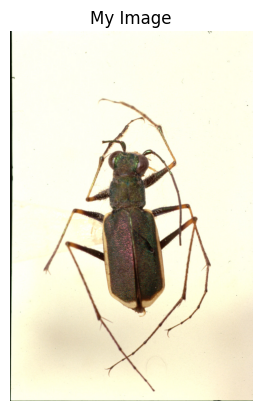

In [10]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the image file
image_path = "/content/Tiger-beetle-image-dataset-main/Training_data/callytron/image_12.jpg"  # Replace with your image path

# Read the image
img = mpimg.imread(image_path)

# Create a figure
# plt.figure(figsize=(8, 8), dpi=400)  # Set figure size and DPI

# Display the image
plt.imshow(img)
plt.axis('off')  # Turn off axis labels
plt.title('My Image')  # Optional title

# Show the plot
plt.show()


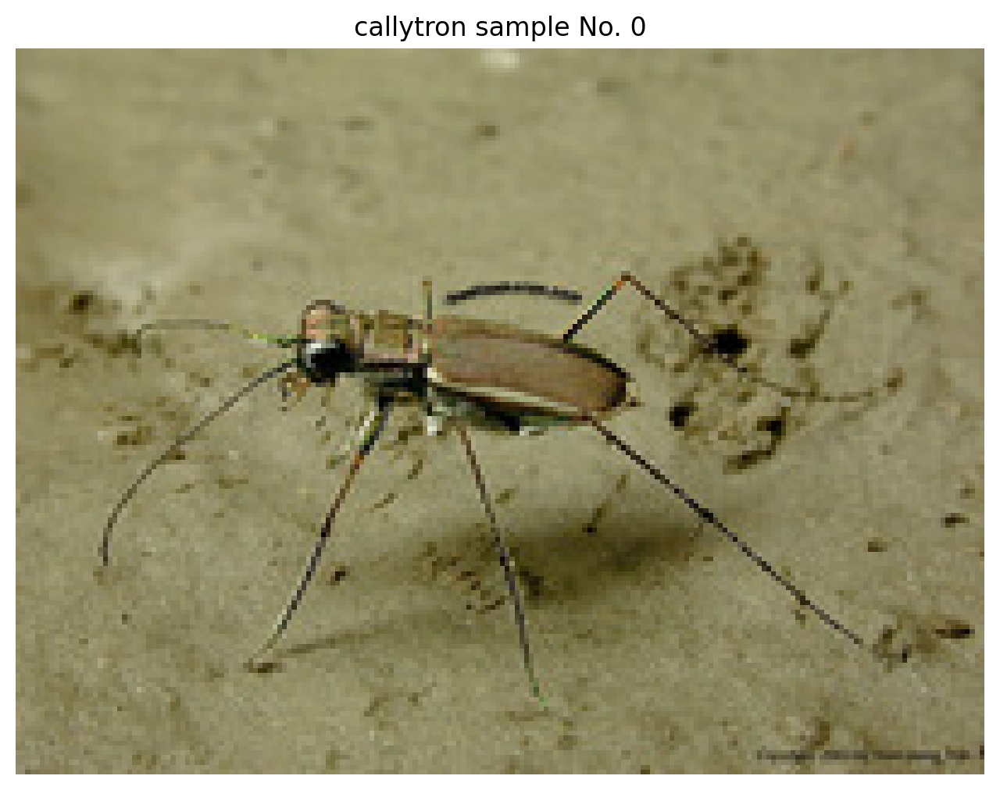

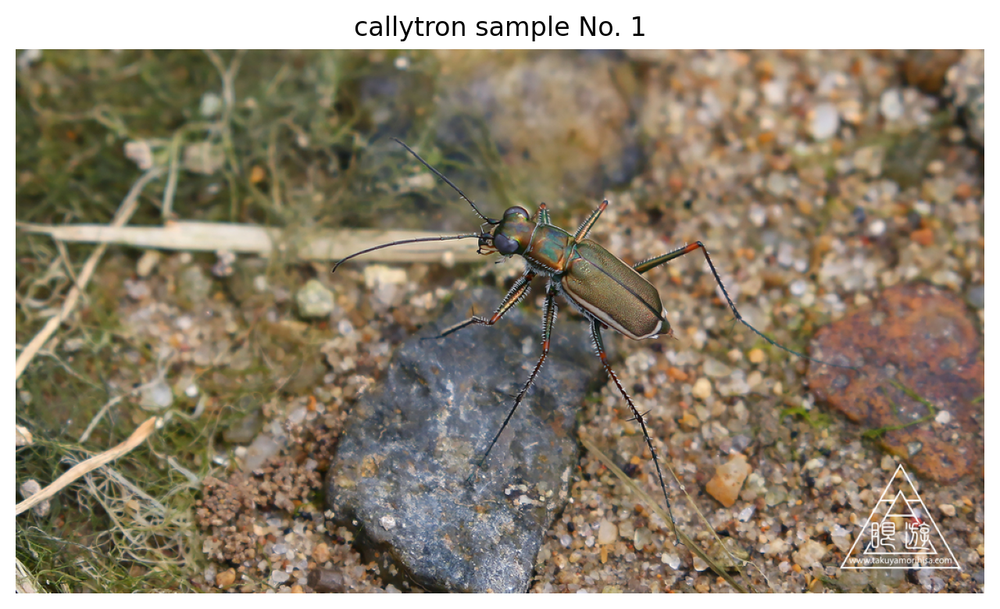

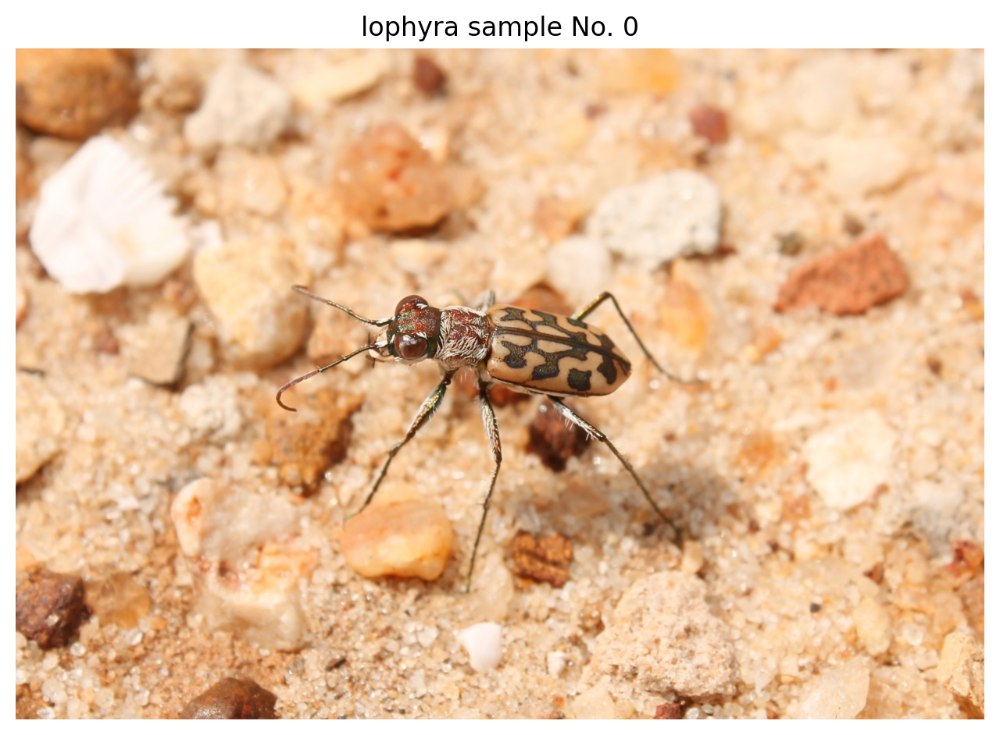

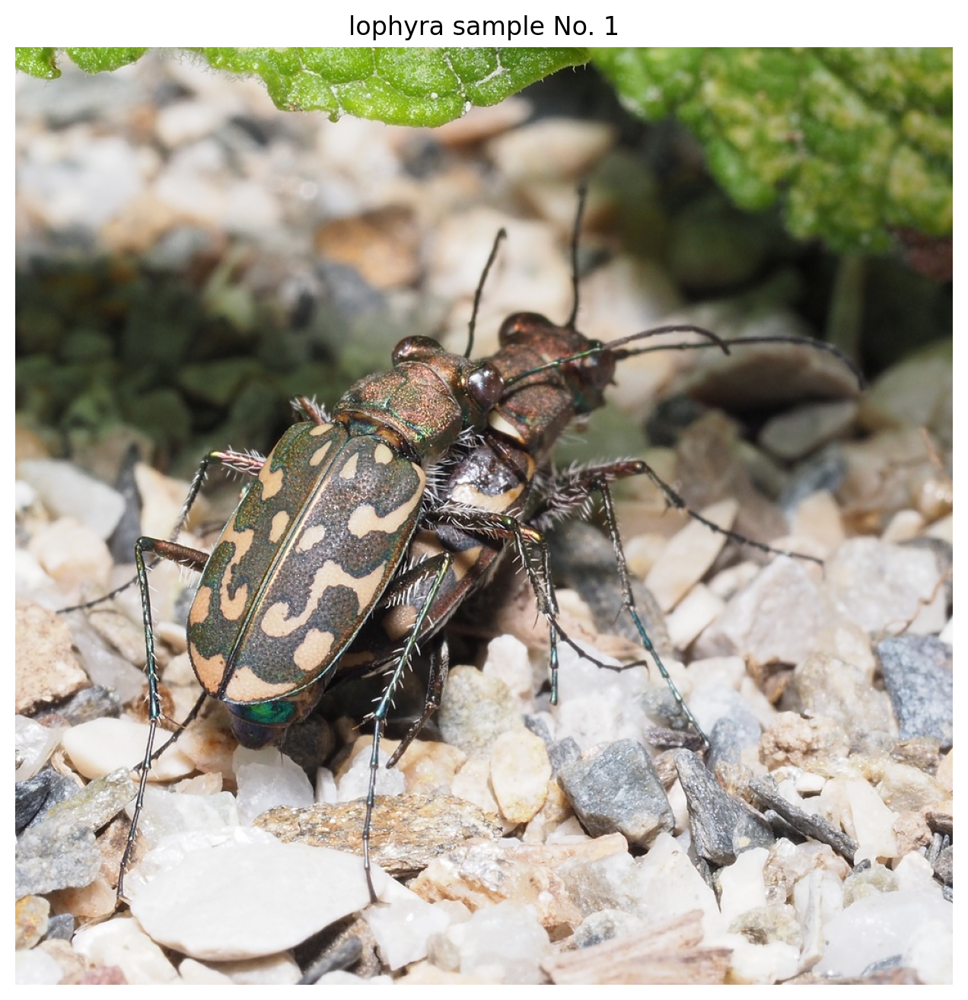

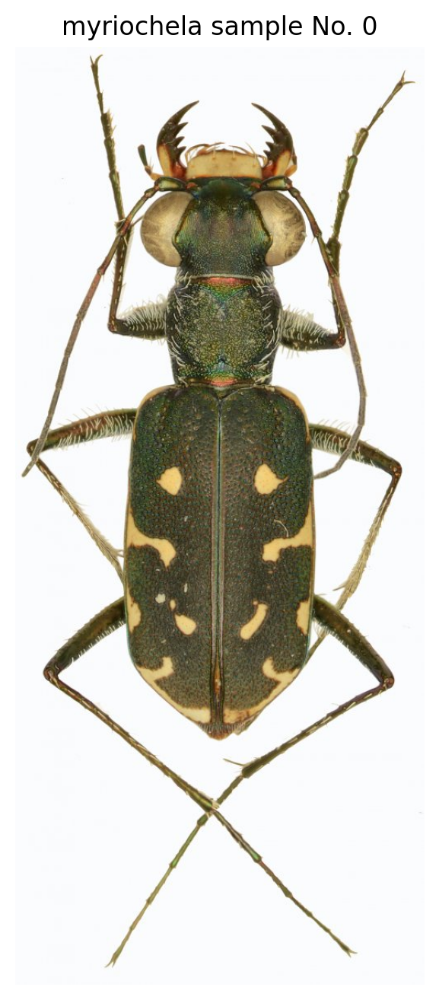

...

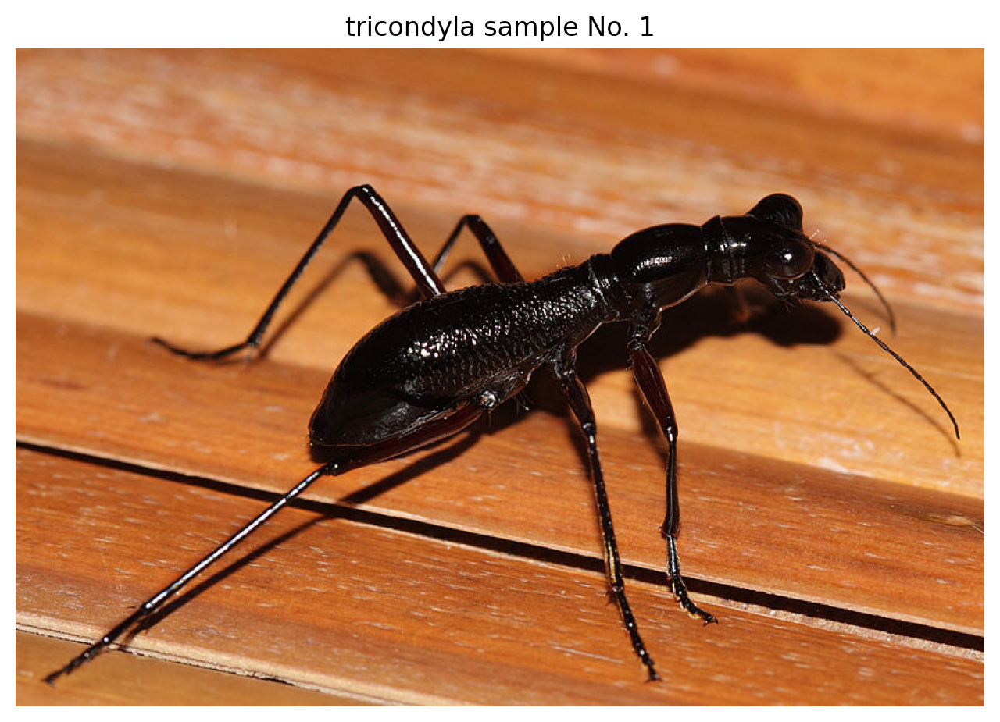

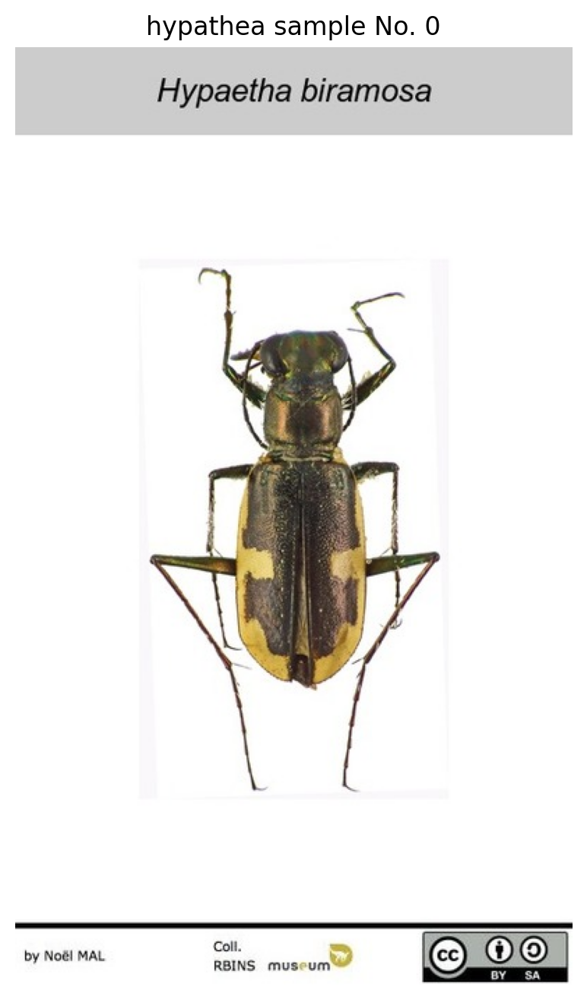

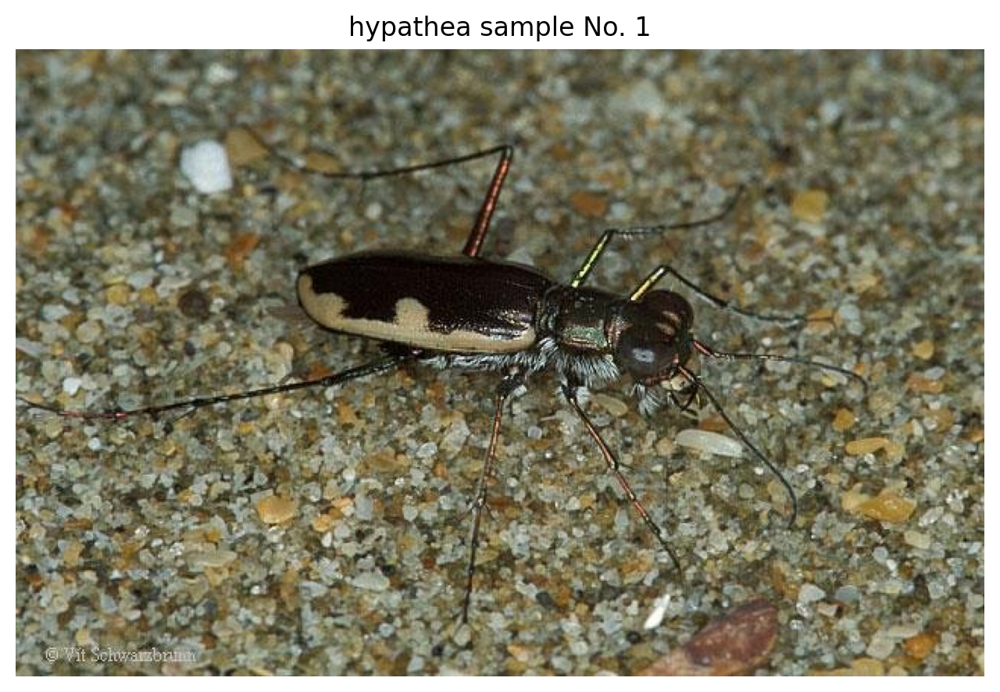

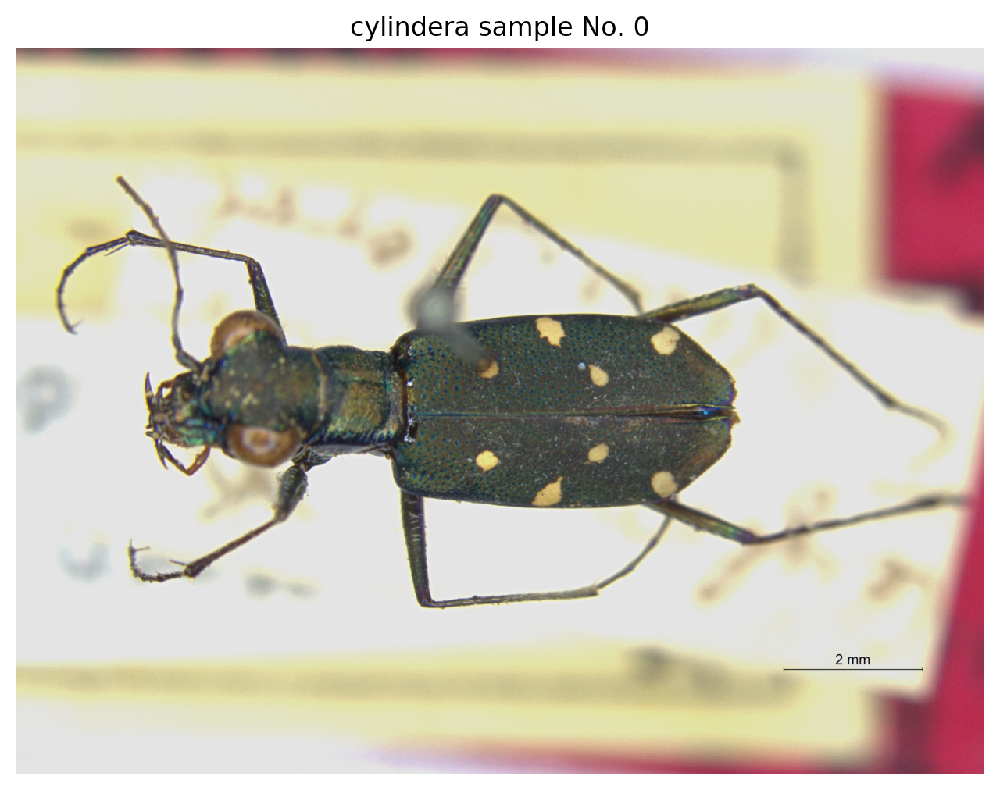

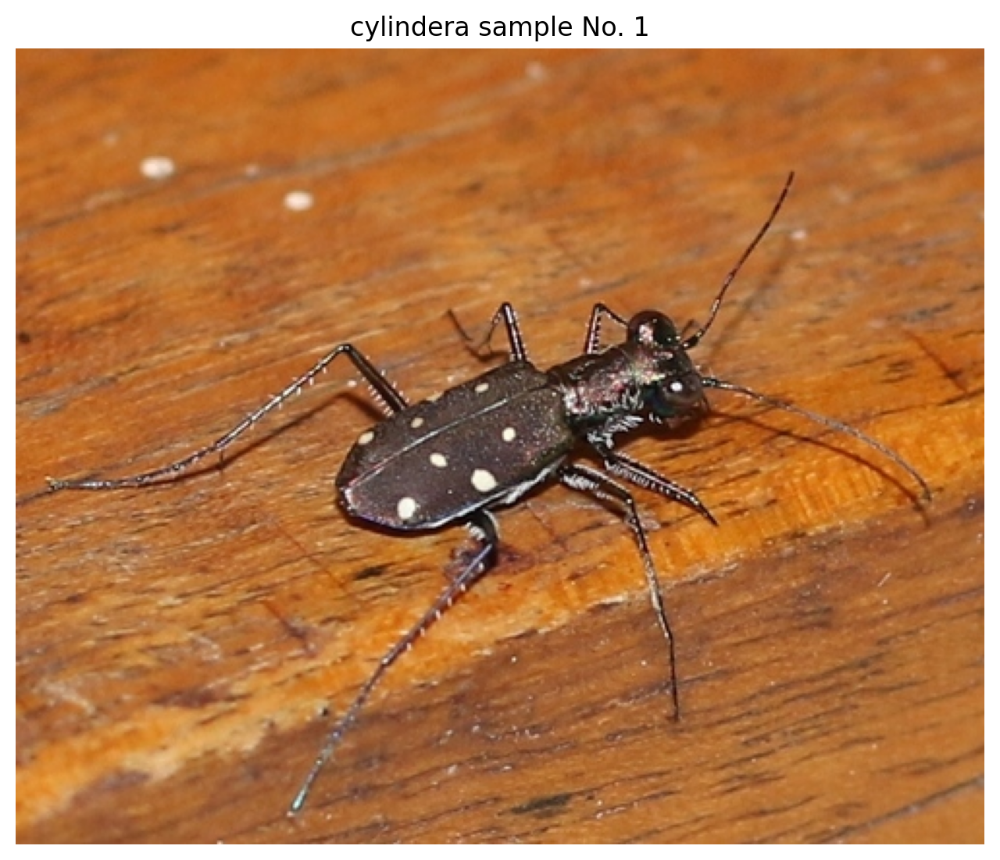

In [11]:
import os
for i,j,k in os.walk("/content/Tiger-beetle-image-dataset-main/Training_data/"):
  for c in j:
    for t,t1,t2 in os.walk(i+c):
      for rnd,rr in enumerate(t2[0:2]):
        # print(t+"/"+rr)
        plt.figure(figsize=(8, 8), dpi=200)
        img = mpimg.imread(t+"/"+rr)
        plt.imshow(img)
        plt.axis('off')  # Turn off axis labels
        plt.title(c+f" sample No. {rnd}")  # Optional title
        plt.savefig(f"/content/drive/MyDrive/image_work/work1/{c} sample No. {rnd}.png",bbox_inches='tight',dpi=300)
        # Show the plot
        plt.show()


    # print(k)

In [5]:
class_names = train_dataset.class_names

In [6]:
class_names

['callytron',
 'calomera',
 'cylindera',
 'derocrania',
 'hypathea',
 'lophyra',
 'myriochela',
 'neocollyris',
 'tricondyla']

In [24]:
import tensorflow as tf

def augment(image, label):
    # Randomly flip the image left-right
    images = tf.keras.layers.Rescaling(1./255),  # Normalize pixel values to [0, 1]
    image = tf.image.random_flip_left_right(image)

    # Randomly flip the image up-down
    image = tf.image.random_flip_up_down(image)

    # Random brightness
    image = tf.image.random_brightness(image, max_delta=0.03)

    # Random contrast
    # image = tf.image.random_contrast(image, lower=0.1, upper=0.8)

    # Random rotation (in radians)
    image = tf.image.rot90(image, k=tf.random.uniform(shape=[], minval=0, maxval=4, dtype=tf.int32))  # Rotate by 0, 90, 180, or 270 degrees

    # Random saturation
    image = tf.image.random_saturation(image, lower=0.1, upper=2.0)  # Random saturation

    return image, label

# Apply data augmentation to the training dataset
train_dataset_augmented = train_dataset.map(augment)


In [25]:
hw = 224
wh = 224

In [26]:
import tensorflow as tf

# Define a simple dense model
model = tf.keras.models.Sequential([
    tf.keras.layers.Flatten(input_shape=(hw, wh, 3)),  # Flatten the 64x64x3 images
    tf.keras.layers.Dense(128, activation='relu'),     # Fully connected layer
    tf.keras.layers.Dense(64, activation='relu'),      # Another fully connected layer
    tf.keras.layers.Dense(7, activation='softmax')     # Output layer with 7 classes (softmax for classification)
])

# Compile the model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',  # Use 'sparse_categorical_crossentropy' as labels are integers
              metrics=['accuracy'])

# Print a summary of the model
model.summary()
print(1)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten_3 (Flatten)                  │ (None, 150528)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_20 (Dense)                     │ (None, 128)                 │      19,267,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_21 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_22 (Dense)                     │ (None, 7)                   │             455 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 19,276,423 (73.53 MB)

 Trainable params: 19,276,423 (73.53 MB)

 Non-trainable params: 0 (0.00 B)

1


In [27]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.applications import ResNet50, MobileNetV2, InceptionV3, Xception, VGG16, EfficientNetB0, EfficientNetB7, DenseNet121, DenseNet169, DenseNet201, NASNetLarge, NASNetMobile
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Set the learning rate
learning_rate = 1e-4

# List of pre-trained models
models_to_test = [ResNet50, MobileNetV2, InceptionV3, Xception, VGG16, EfficientNetB0, EfficientNetB7, DenseNet121, DenseNet169, DenseNet201, NASNetLarge, NASNetMobile]
model_names = ["ResNet50", "MobileNetV2", "InceptionV3", "Xception", "VGG16", "EfficientNetB0", "EfficientNetB7", "DenseNet121", "DenseNet169", "DenseNet201", "NASNetLarge", "NASNetMobile"]

In [28]:
res = "/content/drive/MyDrive/image_work/work1/res/"

In [29]:
# Function to store predictions in a DataFrame
def save_predictions(dataset, model, label_col='label', output_file='predictions.csv'):
    true_labels = []
    predictions = []
    probabilities = []

    # Iterate through the dataset to collect true labels and predictions
    for images, labels in dataset:
        preds = model.predict(images)  # Get predictions
        predicted_classes = tf.argmax(preds, axis=1)  # Get the class with the highest probability

        true_labels.extend(labels.numpy())  # Append true labels
        predictions.extend(predicted_classes.numpy())  # Append predicted classes
        probabilities.extend(preds)  # Append predicted probabilities

    # Create a DataFrame to store the results
    results_df = pd.DataFrame({
        'True Label': true_labels,
        'Predicted Class': predictions,
        'Predicted Probability': probabilities
    })

    # Save the DataFrame to a CSV file
    results_df.to_csv(output_file, index=False)

In [30]:
import matplotlib.pyplot as plt

def plot_history(history, model_name):
    # Plot accuracy
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'{model_name} Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.savefig(f"{res}/{model_name}_acc_.png",dpi=300)
    pd.DataFrame.from_dict(history.history).to_csv(f"{res}/{model_name}.csv",index=False)
    plt.show()

    # Plot loss
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'{model_name} Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(f"{res}/{model_name}_loss_.png",dpi=300)
    plt.show()



In [31]:
num_classes = len(train_dataset.class_names)

In [32]:
import tensorflow as tf
from tensorflow.keras import layers, regularizers
from tensorflow.keras.optimizers import Adam


In [ ]:
def create_fine_tuned_model(base_model_class, input_shape=(hw, wh, 3), num_classes=7):
    # Load the pre-trained model without the top classification layers
    base_model = base_model_class(weights='imagenet', include_top=False, input_shape=input_shape)

    # Freeze the base model (optional: you can unfreeze later for fine-tuning)
    base_model.trainable = False

    # Create a new model on top
    model = tf.keras.Sequential([
    layers.GlobalAveragePooling2D(),  # Pool the features from the base model
    layers.Dropout(0.2),               # Dropout layer to prevent overfitting
    # layers.Dense(64, activation='relu',
    #              kernel_regularizer=regularizers.l2(0.01)),  # L2 regularization
    # layers.Dropout(0.2),               # Another Dropout layer
    layers.Dense(num_classes, activation='softmax')  # Final classification
    ])

    return model

# Compile, train, and evaluate each pre-trained model with the added Dense layer
for model_class, model_name in zip(models_to_test, model_names):
    print(f"\nTraining and evaluating {model_name} with fine-tuning...")

    # Create the model
    model = create_fine_tuned_model(model_class, input_shape=(hw, wh, 3), num_classes=num_classes)

    # Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(weight_decay=0.01),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    # Train the model
    history = model.fit(train_dataset, validation_data=validation_dataset, epochs=100)
    save_predictions(train_dataset, model, output_file=f'{res}/{model_name}_train_predictions.csv')

    # Evaluate the model
    val_loss, val_accuracy = model.evaluate(validation_dataset)
    save_predictions(validation_dataset, model, output_file=f'{res}/{model_name}_val_predictions.csv')

    # Example usa
    print(f"\n{model_name} Validation Loss: {val_loss}")
    print(f"{model_name} Validation Accuracy: {val_accuracy}")
    # Example usage (after training each model):
    model.summary()
    # plot_history(history, model_name)




Training and evaluating ResNet50 with fine-tuning...
Epoch 1/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 8s 526ms/step - accuracy: 0.0999 - loss: 212.4579 - val_accuracy: 0.0721 - val_loss: 237.1859
Epoch 2/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 6s 642ms/step - accuracy: 0.1181 - loss: 196.9794 - val_accuracy: 0.0721 - val_loss: 229.9209
Epoch 3/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 9s 565ms/step - accuracy: 0.1238 - loss: 197.2835 - val_accuracy: 0.0721 - val_loss: 222.7450
Epoch 4/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 10s 597ms/step - accuracy: 0.0949 - loss: 185.3222 - val_accuracy: 0.0721 - val_loss: 215.6745
Epoch 5/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 7s 693ms/step - accuracy: 0.1155 - loss: 175.0015 - val_accuracy: 0.0721 - val_loss: 208.6036
Epoch 6/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 4s 439ms/step - accuracy: 0.1088 - loss: 179.1170 - val_accuracy: 0.0721 - val_loss: 201.3699
Epoch 7/100
10/10 ━━━━━━━━━━━━━━━━━━━━ 6s 570ms/step - accuracy: 0.1204 - loss: 171.5924 - val_accuracy: 0.0721 - val_loss: 194.1047
Epoch 8/100
10